In [1]:
using Pkg
Pkg.activate(joinpath(@__DIR__, ".."))
import SatelliteDynamics
using Random
Random.seed!(0)

include("../src/satellite_simulator.jl")
include("../src/detumble_controller.jl")
include("../src/satellite_models.jl")


  Activating project at `~/research/non-monotonic-detumbling`


3×3 Matrix{Float64}:
 0.001  0.0    0.0
 0.0    0.003  0.0
 0.0    0.0    0.005

In [10]:

params = OrbitDynamicsParameters(py4_model_diagonal;
    distance_scale=1.0,
    time_scale=1.0,
    angular_rate_scale=1.0,
    control_scale=1,
    control_type=:dipole,
    magnetic_model=:IGRF13,
    add_solar_radiation_pressure=false,
    add_sun_thirdbody=false,
    add_moon_thirdbody=false)
tspan = (0.0, 2 * 60 * 60.0)

discrete_nonmonotonic_controller(x_, t_, p_) = bderivative_control(x_, t_, p_; k=3e2, saturate=true, α=1, tderivative=10*60)
lyapunov_controller(x_, t_, p_) = bmomentum_control(x_, t_, p_; k=2e3, saturate=true)

lyapunov_controller (generic function with 1 method)

In [11]:
x0_slow_convergence_nonmonotonic_1 = [
    -4.1628567330549057e6
    -5.306506928219943e6
    674343.9346437809
    -5877.838764245214
    4767.955741465907
    1234.665957847444
    0.11088786668301709
    0.2662143704498116
    0.20039313748282506
    0.936309980956248
    0.460030793843411
    0.029097933119768715
    0.7409915846153248
]

# x0_slow_convergence_nonmonotonic_1[11:13] .*= 0.5

xhist_slow_nm_1, uhist_slow_nm_1, thist_slow_nm_1 = simulate_satellite_orbit_attitude_rk4(
    x0_slow_convergence_nonmonotonic_1,
    params,
    tspan;
    integrator_dt=0.1,
    controller=discrete_nonmonotonic_controller,
    controller_dt=0.0
    )


([-4.1628567330549057e6 -4.163444490249672e6 … -3.6536632795860865e6 -3.653032323663817e6; -5.306506928219943e6 -5.306030098636595e6 … 5.63377697282447e6 5.63420098678643e6; … ; 0.029097933119768715 0.07428632703859768 … 0.12673383311822436 0.1290141751174705; 0.7409915846153248 0.7400130287551624 … 0.31116364951451325 0.31088023301266465], [-0.06997731147540984 -0.06997731147540984 … 0.01997788513082231 0.01997788513082231; 0.053130000000000004 0.053130000000000004 … -0.028747670204383832 -0.028747670204383832; 0.053286990400441755 0.03982413510802095 … 0.00981003614491452 0.00981003614491452], [0.0, 0.1, 0.2, 0.30000000000000004, 0.4, 0.5, 0.6000000000000001, 0.7000000000000001, 0.8, 0.9  …  7199.0, 7199.1, 7199.200000000001, 7199.3, 7199.400000000001, 7199.5, 7199.6, 7199.700000000001, 7199.8, 7200.0])

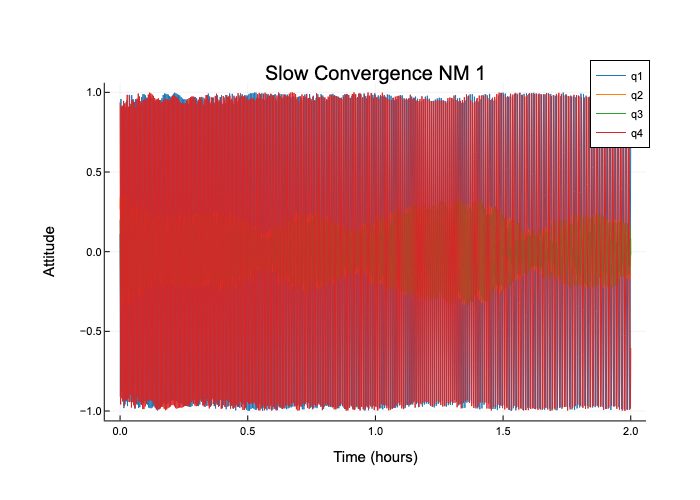

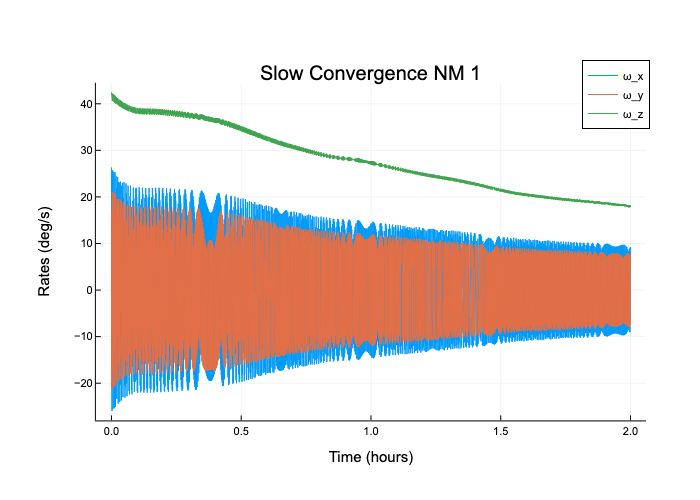

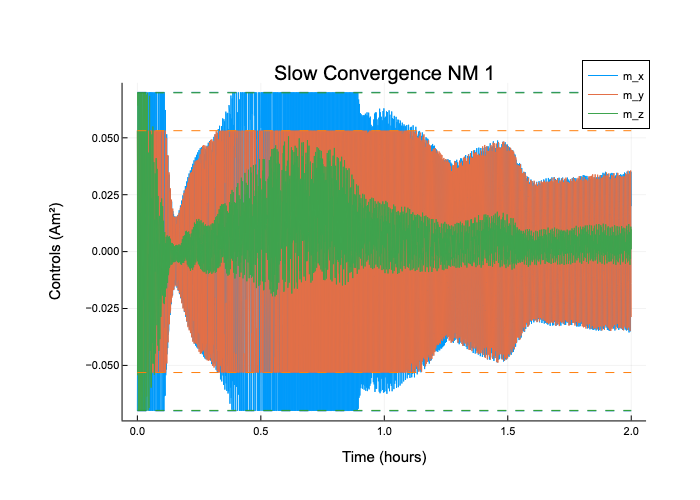

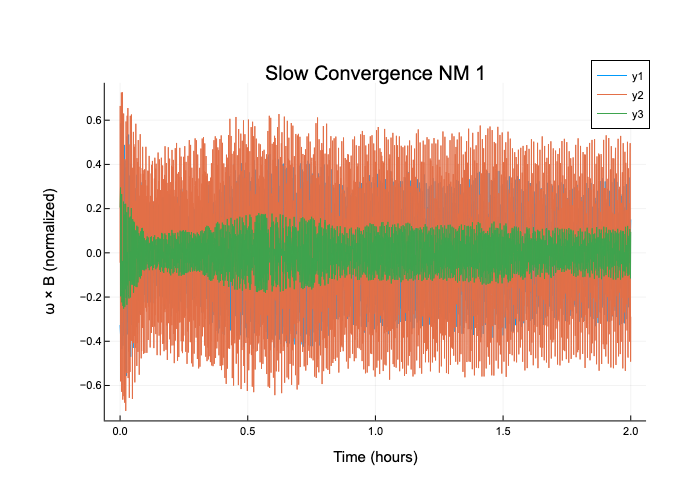

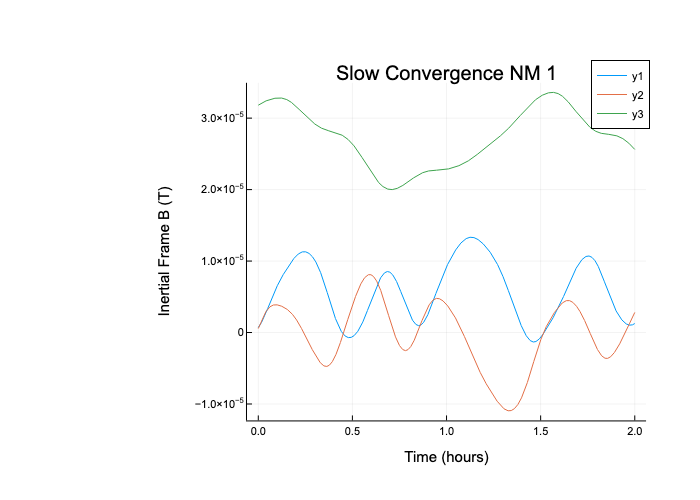

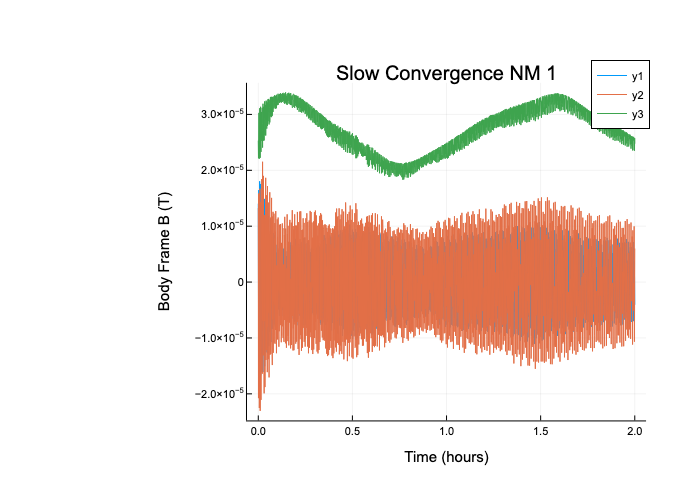

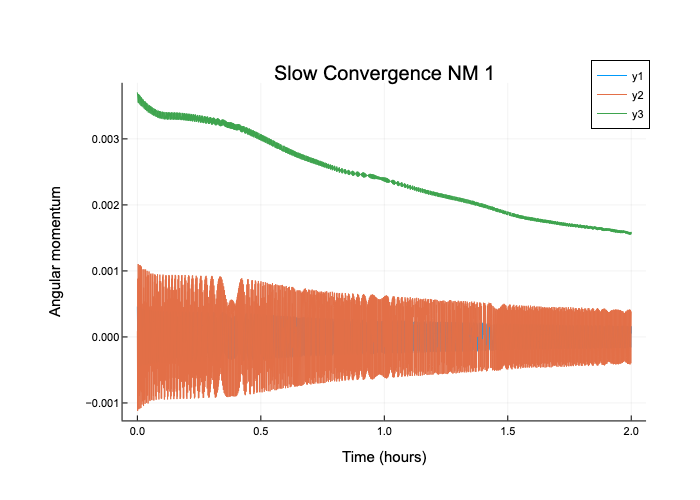

In [12]:

display(plot_attitude(thist_slow_nm_1[:], xhist_slow_nm_1[:,:]; title="Slow Convergence NM 1", max_samples=3600))
display(plot_rates(thist_slow_nm_1[:], xhist_slow_nm_1[:,:]; title="Slow Convergence NM 1", max_samples=3600))
display(plot_controls(thist_slow_nm_1[:], uhist_slow_nm_1[:,:], params; title="Slow Convergence NM 1", max_samples=3600))
display(plot_omega_cross_B(thist_slow_nm_1[:], xhist_slow_nm_1[:,:], params; title="Slow Convergence NM 1", max_samples=3600))
display(plot_B_inertial(thist_slow_nm_1[:], xhist_slow_nm_1[:,:], params; title="Slow Convergence NM 1", max_samples=3600))
display(plot_B_body(thist_slow_nm_1[:], xhist_slow_nm_1[:,:], params; title="Slow Convergence NM 1", max_samples=3600))
display(plot_angular_momentum(thist_slow_nm_1[:], xhist_slow_nm_1[:,:], params; title="Slow Convergence NM 1", max_samples=3600))

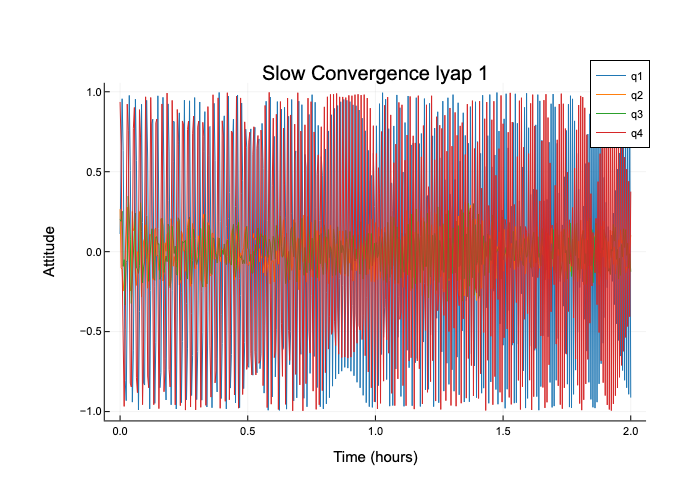

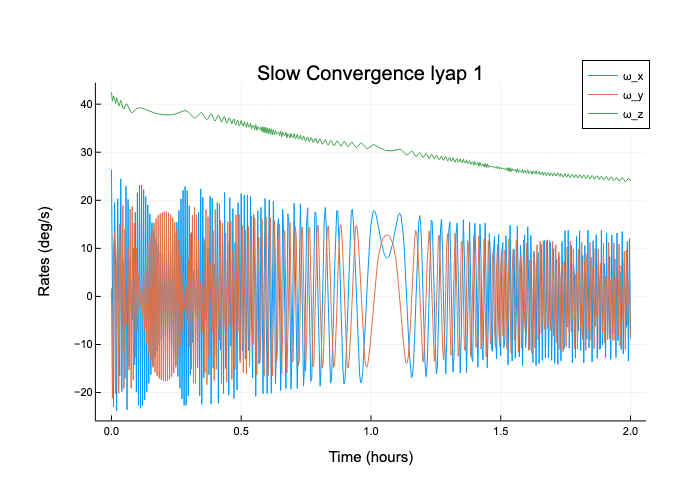

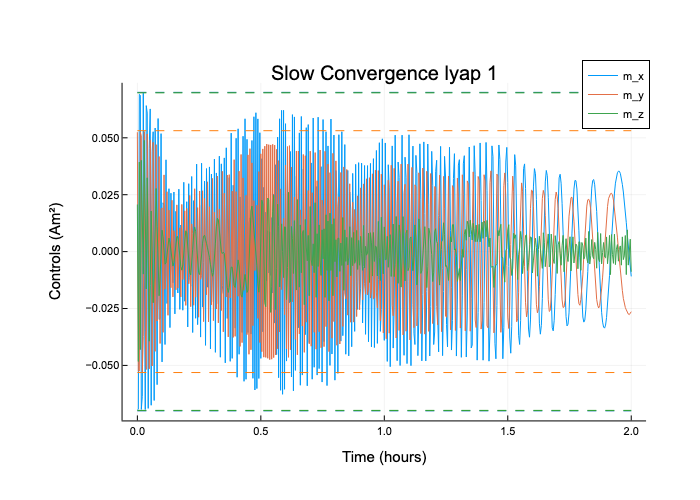

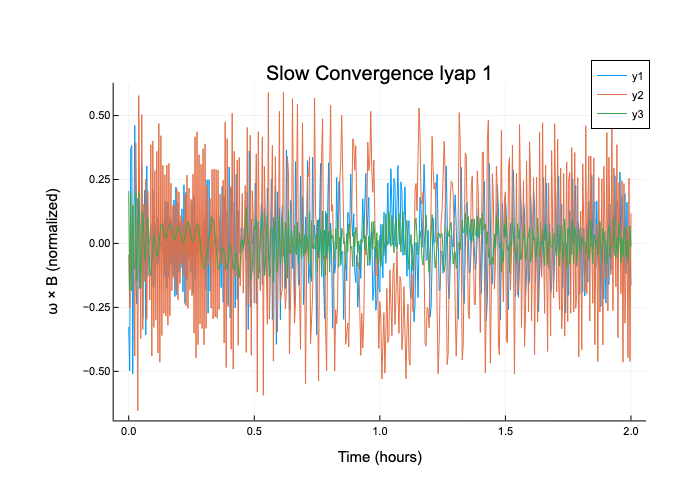

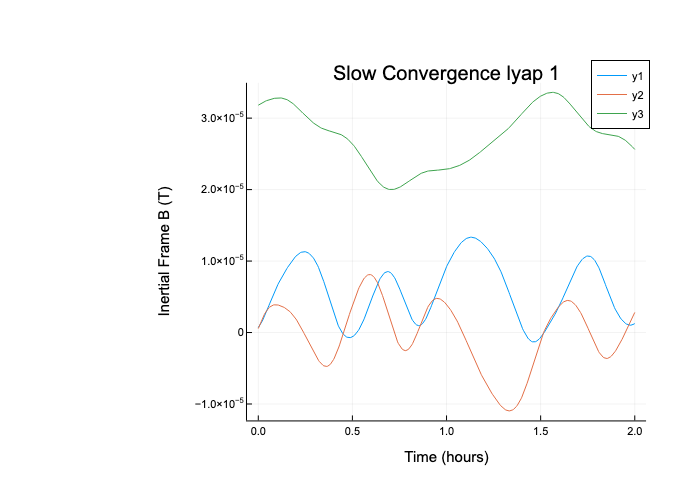

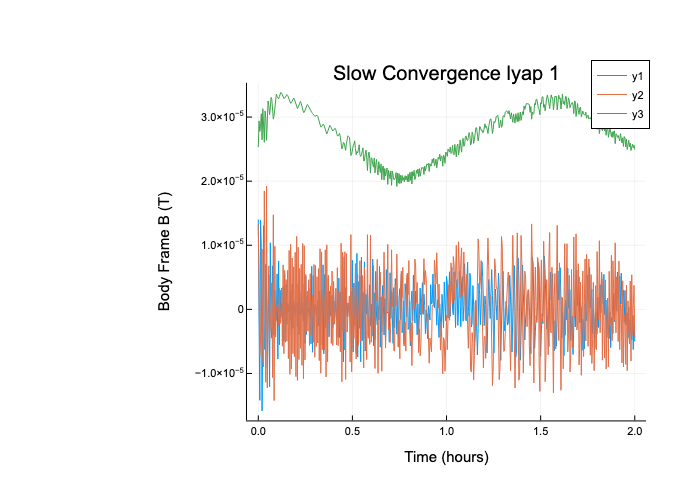

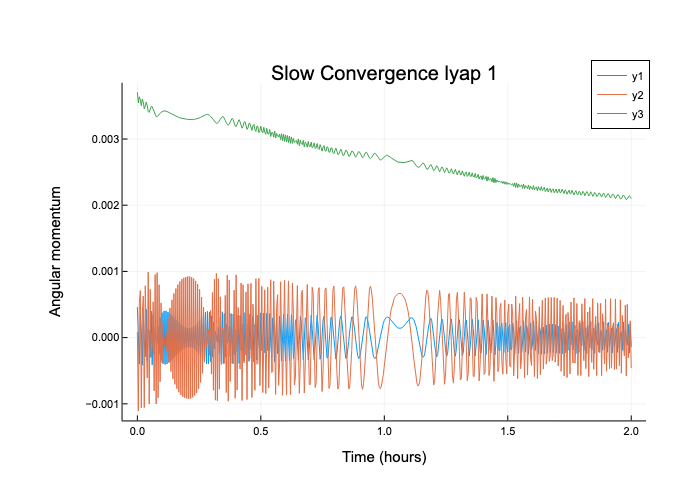

In [13]:
xhist_slow_lyap_1, uhist_slow_lyap_1, thist_slow_lyap_1 = simulate_satellite_orbit_attitude_rk4(
    x0_slow_convergence_nonmonotonic_1,
    params,
    tspan;
    integrator_dt=0.05,
    controller=lyapunov_controller,
    controller_dt=0.0
    )

display(plot_attitude(thist_slow_lyap_1, xhist_slow_lyap_1; title="Slow Convergence lyap 1", max_samples=500))
display(plot_rates(thist_slow_lyap_1, xhist_slow_lyap_1; title="Slow Convergence lyap 1", max_samples=500))
display(plot_controls(thist_slow_lyap_1, uhist_slow_lyap_1, params; title="Slow Convergence lyap 1", max_samples=500))
display(plot_omega_cross_B(thist_slow_lyap_1, xhist_slow_lyap_1, params; title="Slow Convergence lyap 1", max_samples=500))
display(plot_B_inertial(thist_slow_lyap_1, xhist_slow_lyap_1, params; title="Slow Convergence lyap 1", max_samples=500))
display(plot_B_body(thist_slow_lyap_1, xhist_slow_lyap_1, params; title="Slow Convergence lyap 1", max_samples=500))
display(plot_angular_momentum(thist_slow_lyap_1, xhist_slow_lyap_1, params; title="Slow Convergence lyap 1", max_samples=500))

In [14]:
x0_fast_convergence_nonmonotonic_1 = [
    -2.0234057698465628e6
    2.581635050152494e6
    5.931620458195887e6
 4040.389311931773
 6367.235624745114
-1392.9630745487195
    0.10875042944798519
    0.844436507373649
    0.2242887444964645
    0.47412539290958866
    0.841132983464954
    0.21190646891854323
    0.05396526749810971
]

xhist_fast_nm_1, uhist_fast_nm_1, thist_fast_nm_1 = simulate_satellite_orbit_attitude_rk4(
    x0_fast_convergence_nonmonotonic_1,
    params,
    tspan;
    integrator_dt=0.1,
    controller=discrete_nonmonotonic_controller,
    controller_dt=0.0
    )


([-2.0234057698465628e6 -2.0230017179477457e6 … 4.01773591981352e6 4.017831184587234e6; 2.581635050152494e6 2.582271757167483e6 … 4.574873145195841e6 4.5744013373398315e6; … ; 0.21190646891854323 0.21742347262527179 … 2.118200275049189e-6 2.117596410418883e-6; 0.05396526749810971 0.04674029935560271 … -4.709868692313965e-7 -4.7104776531430626e-7], [0.05864158760804729 0.05527028139339938 … 8.055034444971064e-7 8.055034444971064e-7; -0.053130000000000004 -0.053130000000000004 … 2.3758637160971328e-7 2.3758637160971328e-7; 0.06976756111111111 0.06976756111111111 … 3.6348562885725203e-7 3.6348562885725203e-7], [0.0, 0.1, 0.2, 0.30000000000000004, 0.4, 0.5, 0.6000000000000001, 0.7000000000000001, 0.8, 0.9  …  7199.0, 7199.1, 7199.200000000001, 7199.3, 7199.400000000001, 7199.5, 7199.6, 7199.700000000001, 7199.8, 7200.0])

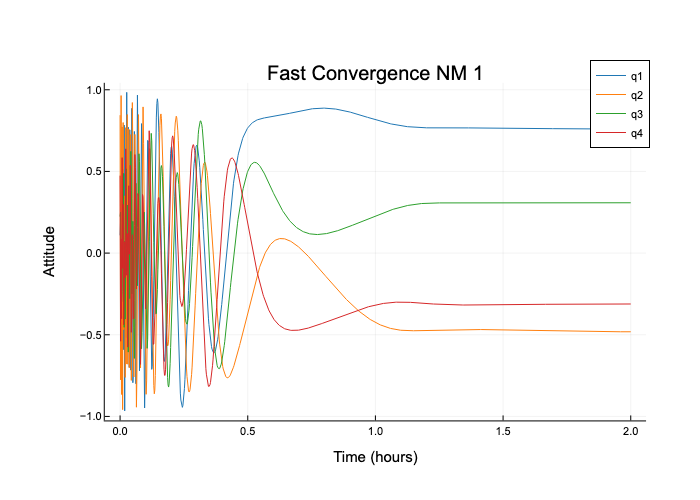

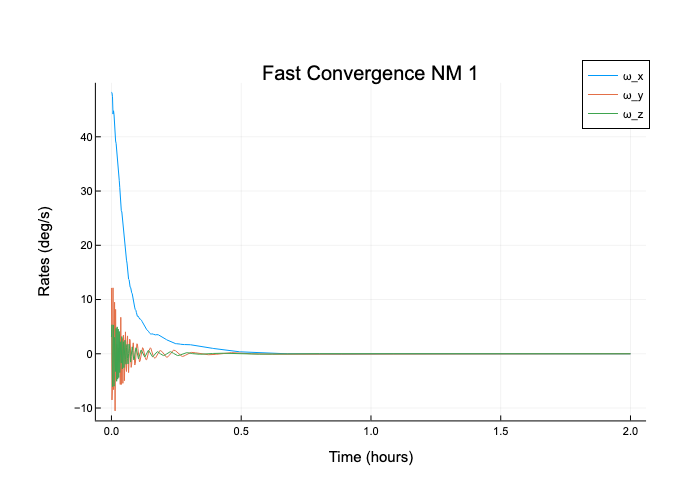

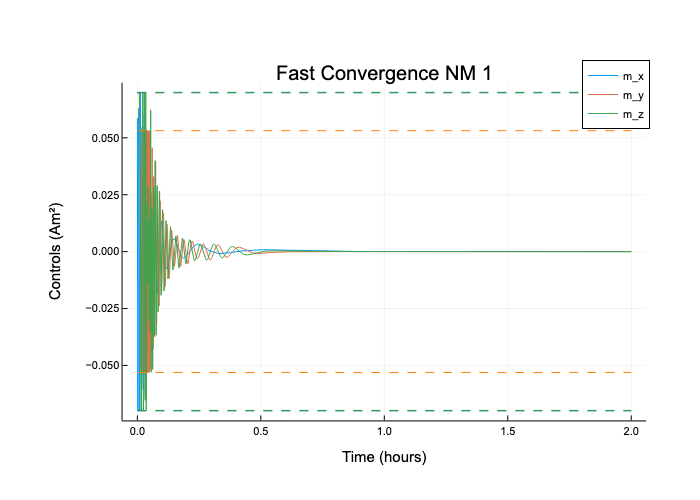

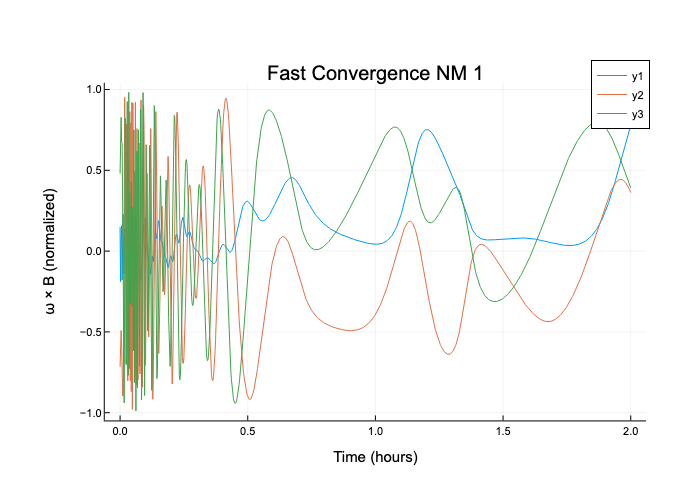

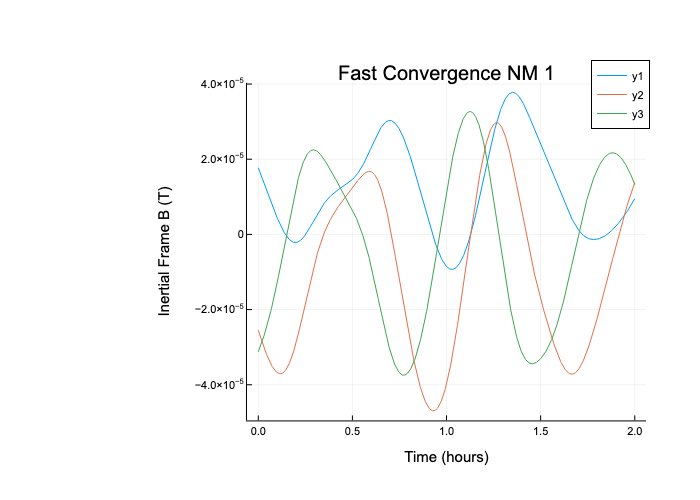

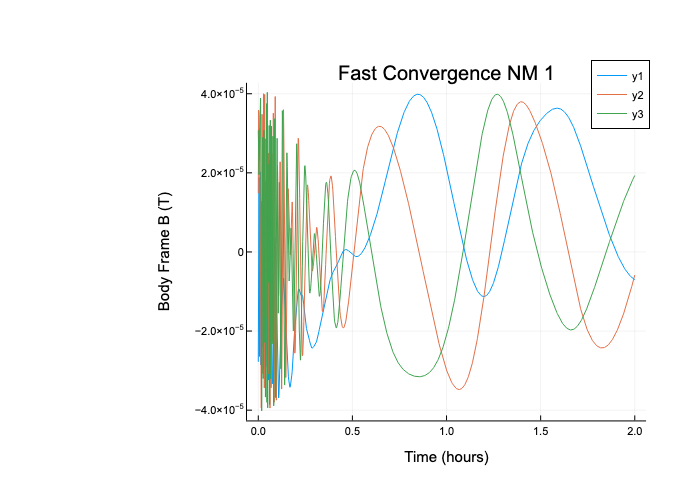

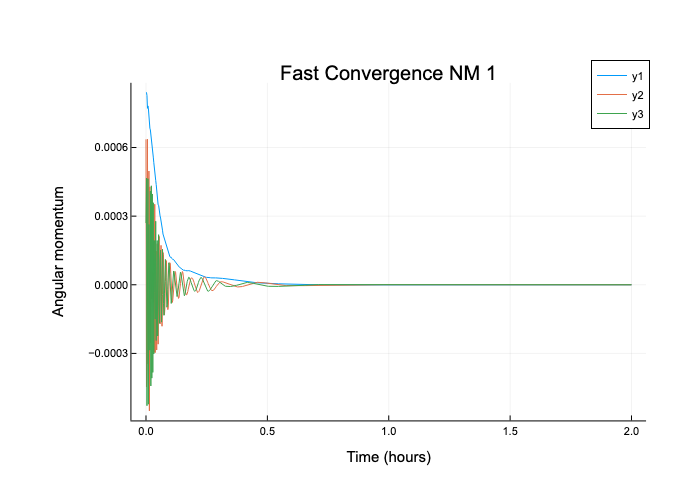

In [15]:
display(plot_attitude(thist_fast_nm_1[:], xhist_fast_nm_1[:,:]; title="Fast Convergence NM 1", max_samples=1000))
display(plot_rates(thist_fast_nm_1[:], xhist_fast_nm_1[:,:]; title="Fast Convergence NM 1", max_samples=1000))
display(plot_controls(thist_fast_nm_1[:], uhist_fast_nm_1[:,:], params; title="Fast Convergence NM 1", max_samples=1000))
display(plot_omega_cross_B(thist_fast_nm_1[:], xhist_fast_nm_1[:,:], params; title="Fast Convergence NM 1", max_samples=1000))
display(plot_B_inertial(thist_fast_nm_1[:], xhist_fast_nm_1[:,:], params; title="Fast Convergence NM 1", max_samples=1000))
display(plot_B_body(thist_fast_nm_1[:], xhist_fast_nm_1[:,:], params; title="Fast Convergence NM 1", max_samples=1000))
display(plot_angular_momentum(thist_fast_nm_1[:], xhist_fast_nm_1[:,:], params; title="Fast Convergence NM 1", max_samples=1000))

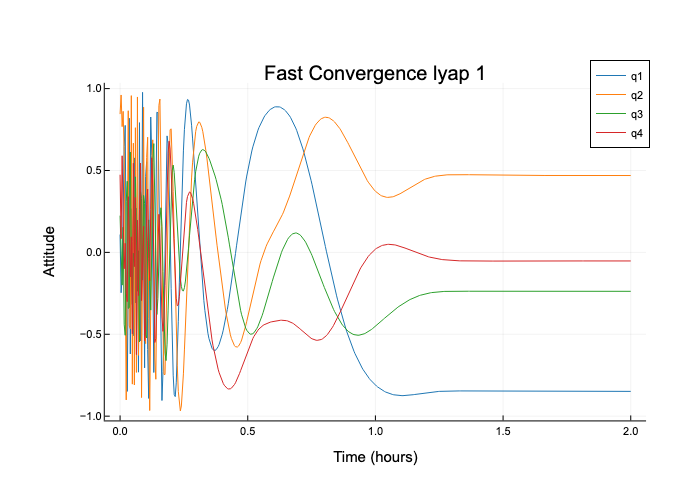

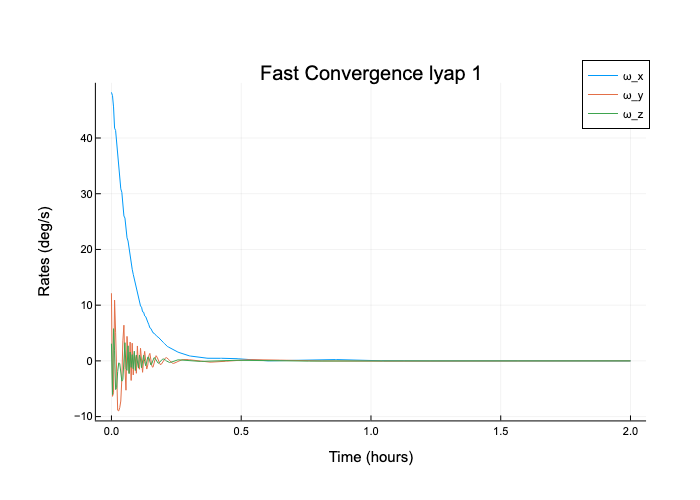

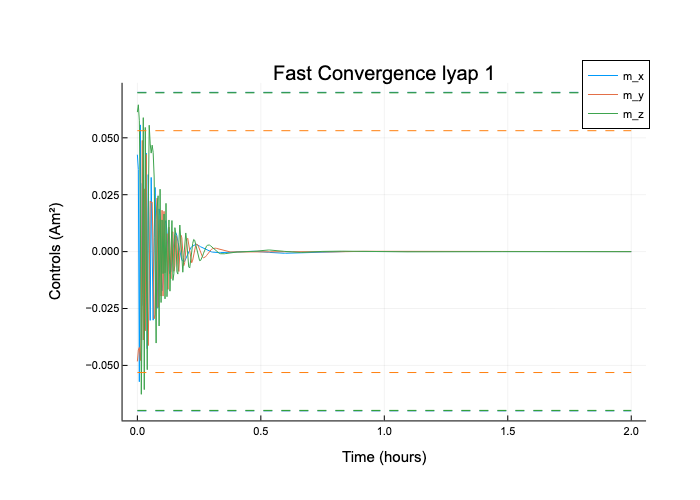

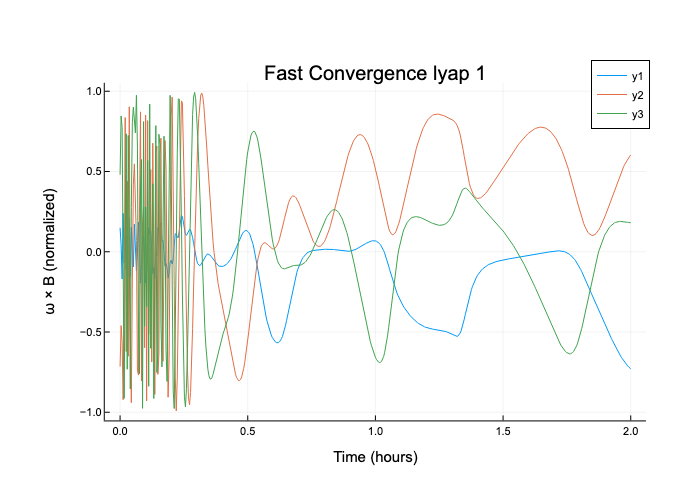

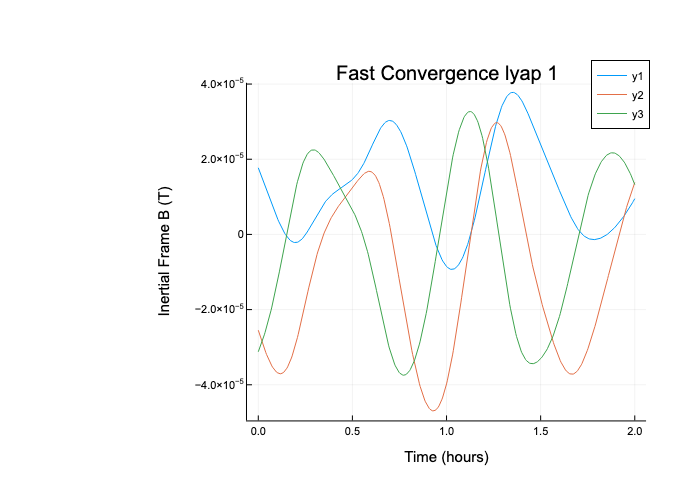

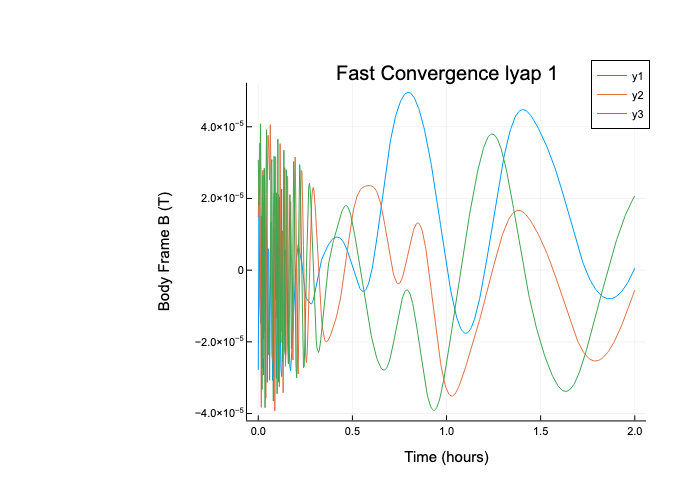

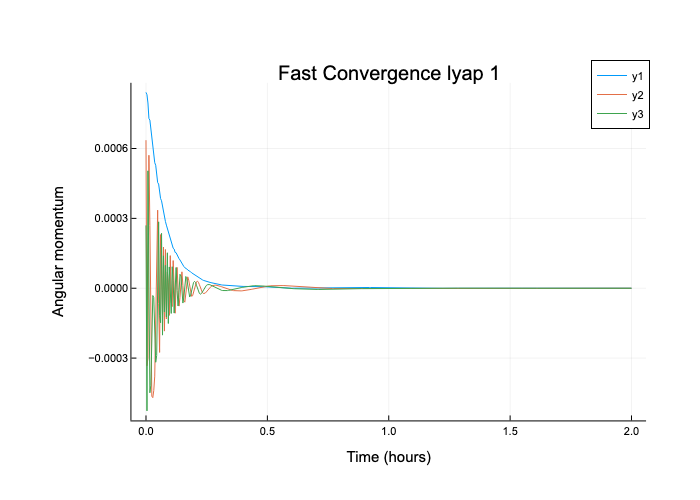

In [16]:
xhist_fast_lyap_1, uhist_fast_lyap_1, thist_fast_lyap_1 = simulate_satellite_orbit_attitude_rk4(
    x0_fast_convergence_nonmonotonic_1,
    params,
    tspan;
    integrator_dt=0.1,
    controller=lyapunov_controller,
    controller_dt=0.0
    )

display(plot_attitude(thist_fast_lyap_1, xhist_fast_lyap_1; title="Fast Convergence lyap 1", max_samples=500))
display(plot_rates(thist_fast_lyap_1, xhist_fast_lyap_1; title="Fast Convergence lyap 1", max_samples=500))
display(plot_controls(thist_fast_lyap_1, uhist_fast_lyap_1, params; title="Fast Convergence lyap 1", max_samples=500))
display(plot_omega_cross_B(thist_fast_lyap_1, xhist_fast_lyap_1, params; title="Fast Convergence lyap 1", max_samples=500))
display(plot_B_inertial(thist_fast_lyap_1, xhist_fast_lyap_1, params; title="Fast Convergence lyap 1", max_samples=500))
display(plot_B_body(thist_fast_lyap_1, xhist_fast_lyap_1, params; title="Fast Convergence lyap 1", max_samples=500))
display(plot_angular_momentum(thist_fast_lyap_1, xhist_fast_lyap_1, params; title="Fast Convergence lyap 1", max_samples=500))